In [3]:
using NonLinearDynamicsCourse
using Plots, DifferentialEquations, LinearAlgebra, DSP, WAV

# N modos version compleja

Ahora tenemos dos ecuaciones para la lengueta  y N ecuaciones complejas para los modos

$\dot{x} = v$

$\dot{v} = -\omega_r v + \omega_r^2 (p-\gamma-x+F_c)$

$\dot{p_n} = s_n p_n + C_n u$

con las funciones (por ahora) sin regularizar:

$p=2 \sum\limits_{n=1}^{N} Re(p_n)$

$F_c = K_c min(x+1,0)^2 (1 − \beta v)$    

$u = \zeta max(x+1,0)sign(\gamma-p)\sqrt{|\gamma-p|}$


In [6]:
# PARAMETROS FIJOS EN LO QUE SIGUE PARA EL MODELO DE N MODOS
ωn = [1.195,2.483,3.727,4.405,5.153,6.177,6.749,7.987]
αn = [0.0176,0.0355,0.0653,0.2693,0.0703,0.166,0.0945,0.1165]
Cn = [0.1761,0.4705,0.6494,0.328,0.541,0.2249,0.3822,0.4099]
sn = -αn+1im*ωn
fs = 16.0
dt = 1/fs
Kc = 100.0
ζ = 0.6
β = 1.0
ω0 = 4.224;

In [4]:
function saxN!(dx,x,p,t)
    γ,ζ,β,ω0,Kc,s,C = p
    P = 2.0*sum(real.(x[3:end]))
    Fc = Kc*min(real(x[1])+1,0)^2*(1-β*x[2])
    u = ζ*max(real(x[1])+1,0)*sign(γ-P)*sqrt(abs(γ-P))
    dx[1] = x[2]
    dx[2] = -ω0*x[2]+ω0^2*(P-γ-x[1]+Fc)
    for n=3:length(x)
        dx[n] = s[n-2]*x[n]+C[n-2]*u
    end    
end

saxN! (generic function with 1 method)

In [5]:
# Armamos una funcion para calular la envolvente de amplitu de cada modo
function envelope(x::Vector, order::Int=1,deriv::Int=3)
    responsetype = Lowpass(0.05; fs=16)
    designmethod = FIRWindow(hanning(128))
    filtfilt(digitalfilter(responsetype, designmethod), abs.(x))
end

envelope (generic function with 3 methods)

In [10]:
# solo definimos los parametros que cambian en el problema: la presion de soplado γ y la cantidad de modos
# la condicion inicial es con x en -γ y todos los modos en 0
γ0 = 0.405
nmodes = 8
xini = vcat([-γ0, 0],repeat([0.0+0.001im],nmodes))
tspan = (0.0,500)
pars = (γ0,ζ,β,ω0,Kc,sn,Cn)
prob = ODEProblem(saxN!, xini, tspan, pars)
sol = solve(prob,saveat=dt)
X = real.(Array(sol));

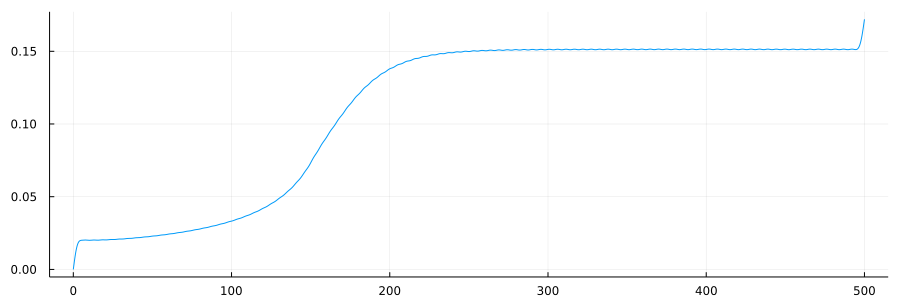

In [12]:
plot(sol.t,envelope(X[3,:]),size=(900,300),legend=false)

# N modos version real

Ahora vamos a tener dos ecuaciones para la lengueta  y 2N ecuaciones reales para los modos

$\dot{x} = v$

$\dot{v} = -\omega_r v + \omega_r^2 \left(\sum p_n -\gamma-x+F_c(x,v) \right)$

$\dot{p_n} = -\alpha_n p_n -2\omega_n q_n + 2C_n u\left(x, \sum p_n \right)$

$\dot{q_n} = -\alpha_n q_n + \omega_n p_n/2$

donde pusimos la dependencia la suma sobre las presiones de cada modo forma explicita y las funciones (sin regularizar):

$F_c(x,v) = K_c min(x+1,0)^2 (1 − \beta v)$    

$u\left(x, \sum p_n \right) = \zeta max(x+1,0)sign\left( \gamma-\sum p_n \right)\sqrt{\left|\gamma-\sum p_n\right|}$


In [1]:
function saxRN!(dx,x,p,t)
    γ,ζ,β,ω0,Kc,α,ω,C = p
    P = sum(x[3:2:end])
    Fc = Kc*min(real(x[1])+1,0)^2*(1-β*x[2])
    u = ζ*max(real(x[1])+1,0)*sign(γ-P)*sqrt(abs(γ-P))
    dx[1] = x[2]
    dx[2] = -ω0*x[2]+ω0^2*(P-γ-x[1]+Fc)
    for n=3:2:length(x)
        m = (n-1)÷2
        dx[n] = -α[m]*x[n]-2*ω[m]*x[n+1]+2*C[m]*u
        dx[n+1] = -α[m]*x[n+1]+0.5*ω[m]*x[n]
    end
    dx
end

saxRN! (generic function with 1 method)

In [88]:
γ0 = 0.405
nmodes = 8
xini = vcat([-γ0, 0],repeat([0.0,0.001],nmodes))
tspan = (0.0,500)
pars = (γ0,ζ,β,ω0,Kc,αn,ωn,Cn);

In [89]:
prob = ODEProblem(saxRN!, xini, tspan, pars)
sol2 = solve(prob,saveat=dt);

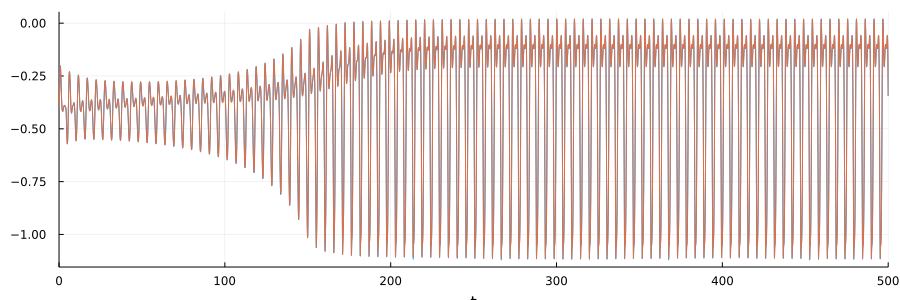

In [91]:
plot(sol2,vars=(0,1),size=(900,300),legend=false)
plot!(sol,vars=((t,x) -> (t,real(x)),0,1))

# Blow como funcion del tiempo

Estudiamos como actuan diferentes acciones de $\gamma$ en funcion del tiempo

Blow con dos escalones y blow con un escalon con un decaimiento exponencial o lineal

In [21]:
# blow con fade in/out y en el medio lineal o exponencial
function blow1(t,tmax,γ1,γ2,γ3=0.7)
    #s = γ2+ (1.0-γ2)*exp(-3.0*t/tmax)
    s = 1.0 + t*(γ2-1.0)/tmax
    if t<0.5*tmax
        return (γ3+(1-γ3)*tanh((t-5*γ1)/γ1))*s
    else
        return (0.5-0.5*tanh((t-tmax+3*γ1)/γ1))*s
    end
end    

blow1 (generic function with 2 methods)

In [22]:
# blow con dos valores
function blow2(t,tmax,γ1,γ2,γ3=0.75)
    if t<tmax*0.3
        return γ3+(1-γ3)*tanh(0.5*(t-5*γ1)/γ1)
    elseif t<0.6*tmax
        return 0.5*(1+γ2)+0.5*(γ2-1)*tanh(0.5*(t-tmax/2)/γ1)
    else
        return 0.5*γ2-0.5*γ2*tanh((t-tmax+3*γ1)/γ1)    
    end
end    

blow2 (generic function with 2 methods)

In [23]:
function saxN_fade!(dx,x,p,t)
    γ0,γ1,γ2,γ3,tmax,ζ,β,ω0,Kc,s,C,blow = p
    γ = γ0*blow(t,tmax,γ1,γ2,γ3)
    P = 2.0*sum(real.(x[3:end]))
    Fc = Kc*min(real(x[1])+1,0)^2*(1-β*x[2])
    u = ζ*max(real(x[1])+1,0)*sign(γ-P)*sqrt(abs(γ-P))
    dx[1] = x[2]
    dx[2] = -ω0*x[2]+ω0^2*(P-γ-x[1]+Fc)
    for n=3:length(x)
        dx[n] = s[n-2]*x[n]+C[n-2]*u
    end    
end

saxN_fade! (generic function with 1 method)

## Blow hasta valor constante. Fade in/out

In [24]:
# la funcion de blow se pasa como parametro en p
tmax = 3200
γ0 = 0.45 # valor maximo de blow
γ1 = 100   # pendiente del fade in/ot en ms
γ2 = 1.0  # declive del blow si es 1 no hay declive
γ3 = 0.9 # valor inicial con relacion a γ0
x0 = vcat([-γ0, 0],repeat([p0],nmodes))
tspan = (0.0,tmax)
p = (γ0,γ1,γ2,γ3,tmax,ζ,β,ω0,Kc,sn,Cn,blow1);

In [25]:
# resolvemos primero un transitorio de 100 ms para encontrar el punto de equilibrio
trans = ODEProblem(saxN_fade!, x0, (0.0, 100), p) 
strans = solve(trans,Tsit5(),save_everystep=false,save_start = false);

In [255]:
prob = ODEProblem(saxN_fade!,strans[end], tspan, p)
sol = solve(prob,Tsit5(),saveat=dt)
X = real.(Array(sol));

In [256]:
P = dropdims(sum(real.(X[3:end,:]),dims=1),dims=1)
plt = plot(sol.t,envelope(X[3,:],501))
for n in 2:nmodes
    plot!(plt,sol.t,envelope(X[n+2,:],501))
end
plot(plt,size=(900,300))

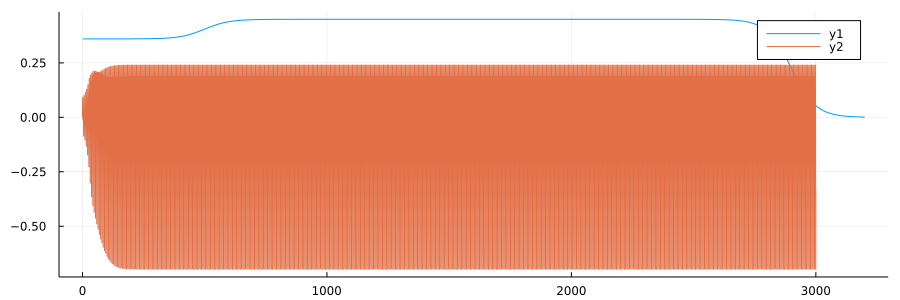

In [26]:
env = [γ0*blow1(t1,tmax,γ1,γ2,γ3) for t1 in 1:3200]
plot(1:3200,env,size=(900,300))
plot!(sol.t,P)

In [258]:
# guardamos en un wav con frecuencia de sampleo 16 kHz
wavwrite(P,"saxo1.wav",Fs = 16e3)

## Dos modos, escalones 

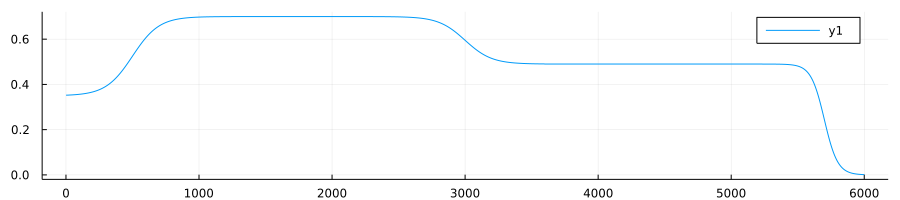

In [27]:
tmax = 6000
γ0 = 0.7
γ1 = 100
γ2 = 0.7
γ3 = 0.75
tspan = (0.0,tmax)
p = (γ0,γ1,γ2,γ3,tmax,ζ,β,ω0,Kc,sn,Cn,blow2);
env = [γ0*blow2(t1,tmax,γ1,γ2,γ3) for t1 in 1:tmax]
plot(1:tmax,env,size=(900,200))

In [28]:
trans = ODEProblem(saxN_fade!, x0, (0.0, 100), p) 
strans = solve(trans,Tsit5(),save_everystep=false,save_start = false);
prob = ODEProblem(saxN_fade!,strans[end], tspan, p)
sol = solve(prob,Tsit5(),saveat=dt)
X = real.(Array(sol));

In [291]:
P = dropdims(sum(real.(X[3:end,:]),dims=1),dims=1)
plt = plot(sol.t,envelope(X[3,:],501))
for n in 2:nmodes
    plot!(plt,sol.t,envelope(X[n+2,:],501))
end
plot(plt,size=(900,300))

In [292]:
wavwrite(P,"saxo2.wav",Fs = 16e3)

## Blow hasta el modo 2 y luego decaimiento
Para atravesar la bifurcacion de Neimarck-Sacker

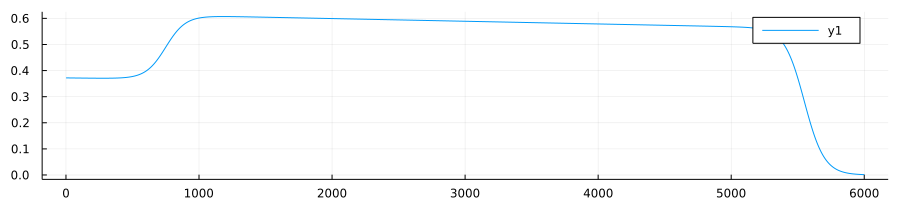

In [279]:
tmax = 6000
γ0 = 0.62
γ1 = 150
γ2 = 0.9
γ3 = 0.8
x0 = vcat([0.18, 0],repeat([p0],nmodes))
tspan = (0.0,tmax)
p = (γ0,γ1,γ2,γ3,tmax,ζ,β,ω0,Kc,sn,Cn,blow1);
env = [γ0*blow1(t1,tmax,γ1,γ2,γ3) for t1 in 1:tmax]
plot(1:tmax,env,size=(900,200))

In [280]:
trans = ODEProblem(saxN_fade!, x0, (0.0, 100), p) 
strans = solve(trans,Tsit5(),save_everystep=false,save_start = false);
prob = ODEProblem(saxN_fade!, strans[end], tspan, p)
sol = solve(prob,Tsit5(),saveat=dt)
X = real.(Array(sol));

In [281]:
P = dropdims(sum(real.(X[3:end,:]),dims=1),dims=1)
plt = plot(sol.t,envelope(X[3,:],501))
for n in 2:nmodes
    plot!(plt,sol.t,envelope(X[n+2,:],501))
end
plot(plt,size=(900,400))

In [282]:
wavwrite(P,"saxo5.wav",Fs = 16e3)

# Multiestabilidad y bifurcaciones

El siguiente es el diagrama de bifurcaciones del sistema con las ramas correspondientes a los modos 1 y 2 en verde y rojo respectivamente y las bifurcaciones indicadas por los discos. H: Hopf, PD: period doubling, F: fold (Saddle Node) y NS: Neimark-Sacker (Hopf sobre un ciclo limite)

<div>
<img src="../files/bifurcation.png" width="700px">
</div>


Como se puede ver una caracteristica importante es la multiestabilidad. En el caso anterior al ir hasta 0.55 hicimos una peque;a excursion por el modo 2 inestable. Vamos a ver ahora si podemos ir a una región donde el modo 2 sea estable

In [ ]:
using BifurcationKit, Setfield

In [44]:
function saxN!(dx,x,p,t)
    γ,ζ,β,ω0,Kc = p
    P = 2.0*sum(real.(x[3:end]))
    Fc = Kc*min(real(x[1])+1,0)^2*(1-β*x[2])
    u = ζ*max(real(x[1])+1,0)*sign(γ-P)*sqrt(abs(γ-P))
    dx[1] = x[2]
    dx[2] = -ω0*x[2]+ω0^2*(P-γ-x[1]+Fc)
    for n=3:length(x)
        dx[n] = sn[n-2]*x[n]+Cn[n-2]*u
    end
    dx
end

saxN! (generic function with 1 method)

In [57]:
#function saxN!(dx,x,p,t)
#γ,ζ,β,ω0,Kc,s,C = p
γ = 0.2
Kc = 100.0
ζ = 0.6
β = 1.0
ω0 = 4.224
nmodes = 8
p0 = 0.0+0im
x0 = vcat([-0.7, 0],repeat([p0],nmodes))
tspan = (0.0,3000)
p = [γ,ζ,β,ω0,Kc];
saxn(u,p) = saxN!(similar(u),u,p,0)
opts = ContinuationPar(pMin=0.2,pMax=0.4, ds = 0.001, dsmax = 0.02,detectBifurcation=3,nInversion=8)

ContinuationPar{Float64, DefaultLS, DefaultEig{typeof(real)}}
  dsmin: Float64 0.001
  dsmax: Float64 0.02
  ds: Float64 0.001
  theta: Float64 0.5
  doArcLengthScaling: Bool false
  gGoal: Float64 0.5
  gMax: Float64 0.8
  thetaMin: Float64 0.001
  a: Float64 0.5
  tangentFactorExponent: Float64 1.5
  pMin: Float64 0.2
  pMax: Float64 0.4
  maxSteps: Int64 100
  finDiffEps: Float64 1.0e-9
  newtonOptions: NewtonPar{Float64, DefaultLS, DefaultEig{typeof(real)}}
  η: Float64 150.0
  saveToFile: Bool false
  saveSolEveryStep: Int64 0
  nev: Int64 3
  saveEigEveryStep: Int64 1
  saveEigenvectors: Bool true
  plotEveryStep: Int64 10
  precisionStability: Float64 1.0e-10
  detectFold: Bool true
  detectBifurcation: Int64 3
  dsminBisection: Float64 1.0e-16
  nInversion: Int64 8
  maxBisectionSteps: Int64 15
  tolBisectionEigenvalue: Float64 1.0e-16
  detectEvent: Int64 0
  tolParamBisectionEvent: Float64 1.0e-16
  detectLoop: Bool false


In [136]:
prob = ODEProblem(saxN!, x0, tspan, p)
sol = solve(prob,saveat=dt)
X = Array(sol);
size(X)

(10, 48001)

In [137]:
plot(imag.(X[:,1:end].-X[:,1])')

In [138]:
x0 = X[:,end]

10-element Vector{ComplexF64}:
   -0.19301571733917788 + 0.0im
  5.3220430673027605e-8 + 0.0im
 0.00046158981910657254 + 0.03134078552332448im
  0.0005761851997593656 + 0.04030016171981687im
  0.0006492191385552048 + 0.037053760446930775im
  0.0009647454140699639 + 0.015780491704013837im
 0.00030463334731356556 + 0.022328992304814683im
 0.00020799522250374976 + 0.007739472977163651im
  0.0001686603441908178 + 0.012044241921571747im
 0.00015926386108100347 + 0.010914612229844961im

In [144]:
P = 2*sum(real.(X[3:end,end]))

0.006984584693160487

In [141]:
P-0.2-real(x0[1])

3.0203233836179066e-7

In [142]:
saxN!(similar(x0),x0,p,0)

10-element Vector{ComplexF64}:
  5.3220430673027605e-8 + 0.0im
   5.164111039579753e-6 - 0.0im
 -2.5653689811333535e-8 + 2.0086218433966116e-9im
  -7.428822225430398e-8 + 1.2109949006251786e-8im
 -1.1884532810646498e-7 + 2.9172210668382964e-8im
   -6.92555327391764e-8 + 1.7133087265759628e-8im
 -1.3310579578817983e-7 + 4.7479678330891034e-8im
  -8.314698581035618e-8 + 3.3975196496015964e-8im
  -1.942981064234628e-7 + 1.0780135529923386e-7im
  1.1689853068874712e-6 + 4.881336770367652e-7im

In [143]:
br1, = continuation(saxn,x0,p,(@lens _[1]), opts)

LoadError: MethodError: no method matching isless(::Float64, ::ComplexF64)
[0mClosest candidates are:
[0m  isless(::Real, [91m::AbstractGray{T} where T[39m) at C:\Users\Camilo\.julia\packages\ColorTypes\6m8P7\src\operations.jl:32
[0m  isless(::Any, [91m::Intervals.AbstractInterval[39m) at C:\Users\Camilo\.julia\packages\Intervals\ua9cq\src\interval.jl:316
[0m  isless([91m::Intervals.AbstractInterval[39m, ::Any) at C:\Users\Camilo\.julia\packages\Intervals\ua9cq\src\interval.jl:315
[0m  ...